# SCANPY - PAGA - Differential analysis

In [1]:
#conda activate scRNA
import numpy as np
import pandas as pd
import matplotlib.pyplot as pl
from matplotlib import rcParams
import scanpy as sc
import os
import csv
from astropy.io import ascii
import seaborn as sns
import matplotlib.pyplot as plt
from collections import Counter
from sklearn.cluster import DBSCAN
import warnings
from matplotlib_venn import venn3

from IPython.core.display import display, HTML
display(HTML("<style>.container { width:90% !important; }</style>"))

warnings.filterwarnings('ignore')
code_dir = os.getcwd()
code_dir
sc.logging.print_versions()

/home/pipkin/anaconda3/envs/scanpy/lib/python3.7/site-packages/anndata/_core/anndata.py:21: FutureWarning: pandas.core.index is deprecated and will be removed in a future version.  The public classes are available in the top-level namespace.
  from pandas.core.index import RangeIndex


scanpy==1.4.5.1 anndata==0.7.1 umap==0.3.10 numpy==1.18.1 scipy==1.4.1 pandas==1.0.1 scikit-learn==0.22.2.post1 statsmodels==0.11.1 python-igraph==0.8.0 louvain==0.6.1


-----

### Info: Exp391 Expressional Level Differential Analysis
1. **Cluster v.s. Cluster** <br>
    1.1 One v.s. all <br>
    1.2 One v.s. one <br>
<br>
2. **Armstrong v.s. Clone13** <br>
    2.1 Armstrong v.s. Clone13 v.s. Naive in all cells <br>
    2.2 Armstrong v.s. Clone13 in each cluster <br>
    2.3 Armstrong v.s. Clone13 in each time point (day5, day8) <br>
    2.4 Conditions v.s. Condition (Armstrong / Clone13 / Naive each time point one v.s. one)

-----

## 0. Read object

In [2]:
wk_dir = "/media/pipkin/Yolanda/Exp391_Acute-Chronic_SC/1_1_SCANPY_PAGA/all--numSlt-rmWTNAV"
os.chdir(wk_dir)

adata = sc.read_h5ad("Exp391.h5ad")

In [3]:
features_df = pd.read_csv('/media/pipkin/Yolanda/Exp391_Acute-Chronic_SC/1_0_cellranger_outs/outs/filtered_feature_bc_matrix/features.tsv', 
                          header=None, sep='\t')
all_genes = list(features_df[1])

In [4]:
gene_n = len(adata.var)
gene_n

2907

-----

In [5]:
# Get set of labels
louvain_newlabel_uniq = list(set(adata.obs['louvain_newlabel']))
louvain_newlabel_uniq.sort()
louvain_newlabel_uniq

### Config
labels_uniq = louvain_newlabel_uniq
obs_useCol = 'louvain_newlabel'

<h1><font size="8"><center> 2. Arm v.s. Cl13 </center></font></h1>

In [6]:
# Working directory of Arm v.s. cl13 comparison
wk_dir = "/media/pipkin/Yolanda/Exp391_Acute-Chronic_SC/1_1_SCANPY_PAGA/all--numSlt-rmWTNAV/1_DifferentialAnalysis/Arm_vs_Cl13"
os.chdir(wk_dir)

# 2.1 Differential Analysis for Arm v.s. Cl13 v.s. NAV All Cluster

In [17]:
# Convert all cell type labels to general labels "A" "C" "N"
adata.obs['cell_type_general'] = [x[0] for x in adata.obs['cell_type']]

# Get set of labels
cell_type_general_uniq = list(set(adata.obs['cell_type_general']))
cell_type_general_uniq.sort()
cell_type_general_uniq

### Config
labels_uniq = cell_type_general_uniq
obs_useCol = 'cell_type_general'

... storing 'cell_type_general' as categorical


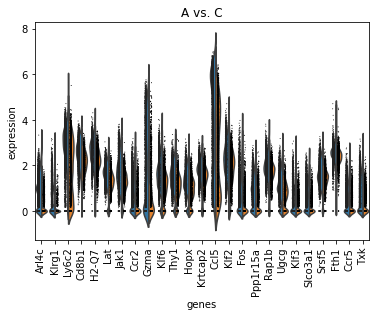

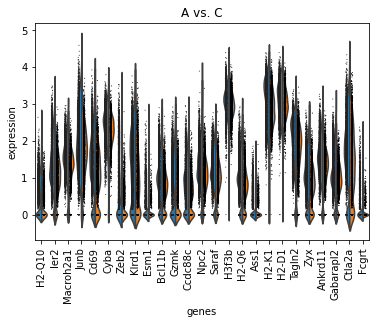

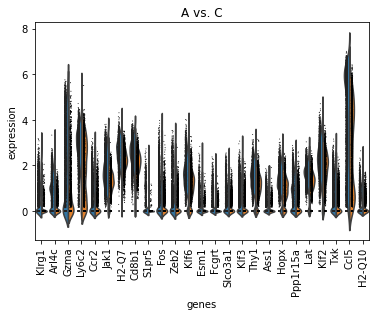

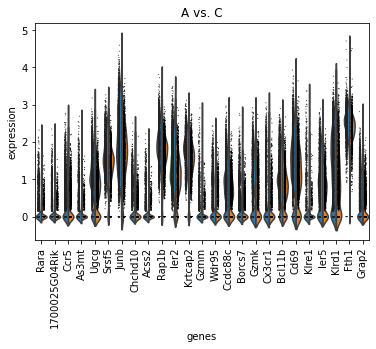

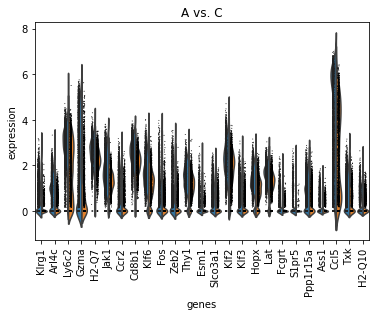

...

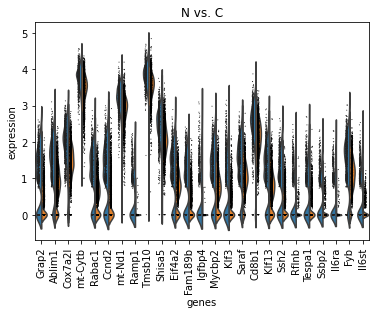

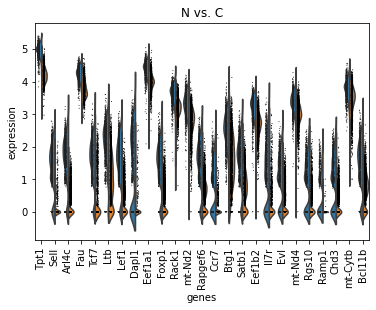

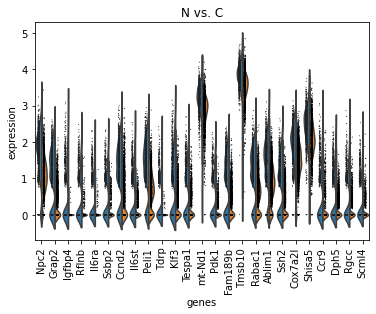

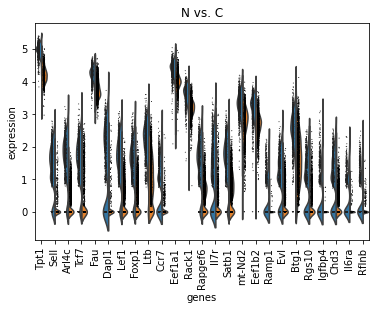

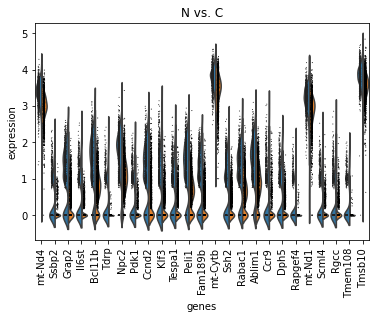

In [18]:
cps = ['wilcoxon', 't-test', 't-test_overestim_var']

for l_t_1 in labels_uniq:
    # Make a new folder for each cluster
    os.chdir(wk_dir)
    if not os.path.exists(l_t_1):
        os.mkdir(l_t_1)
    os.chdir(l_t_1)
    
    for l_t_2 in labels_uniq:
        if l_t_2 != l_t_1:
            
            # Test result summary dataframe
            genes_df_l_t = pd.DataFrame({"gene_names":all_genes})
            dict_l_t = {}
            for cp in cps:
                # Run test
                sc.tl.rank_genes_groups(adata, obs_useCol, groups=[l_t_1], reference=l_t_2, method=cp, n_genes=gene_n)

                # Build dataframe with test results
                cp_names = [x[0] for x in adata.uns['rank_genes_groups']['names']]
                cp_fc = [x[0] for x in adata.uns['rank_genes_groups']['logfoldchanges']]
                cp_score = [x[0] for x in adata.uns['rank_genes_groups']['scores']]
                cp_padj = [x[0] for x in adata.uns['rank_genes_groups']['pvals_adj']]
                cp_df = pd.DataFrame({"gene_names":cp_names, "%s_logfc"%cp: cp_fc, "%s_padj"%cp:cp_padj, "%s_score"%cp:cp_score})
                #cp_df = cp_df[cp_df['%s_padj'%cp]<= 0.05]

                # Plot top 50 differential genes
                diff = cp_df['gene_names']
                diff_rmRp = [x for x in list(diff) if not x.startswith("Rp")]
                if (len(diff_rmRp) >= 25):
                    sc.pl.rank_genes_groups_violin(adata, groups=l_t_1, gene_names=diff_rmRp[:25], 
                                                   save="_vs_%s--%s-25.png"%(l_t_2, cp))
                if (len(diff_rmRp) >= 50):
                    sc.pl.rank_genes_groups_violin(adata, groups=l_t_1, gene_names=diff_rmRp[25:50], 
                                                   save="_vs_%s--%s-50.png"%(l_t_2, cp))

                # Merge with total dataframe
                genes_df_l_t = pd.merge(genes_df_l_t, cp_df, how='outer', on="gene_names")
                dict_l_t[cp] = cp_df['gene_names']
            
            # Save results for all tests
            genes_df_l_t.to_csv("%s_vs_%s_differential.csv"%(l_t_1, l_t_2), index=False)
            
            # Test comparison venn diagram
            venn3([set(dict_l_t[cps[0]]), set(dict_l_t[cps[1]]), set(dict_l_t[cps[2]])], tuple(cps))

            outname = "%s_vs_%s_venn.png"%(l_t_1, l_t_2)
            plt.savefig(outname)
            plt.close()

# 2.2 Differential Analysis for Arm v.s. Cl13 v.s. NAV in each cluster

In [19]:
# Convert all cell type labels to general labels "A" "C" "N"
adata.obs['louvain_cellType'] = ["%s_%s"%(str(x),y) for index,(x,y) in 
                                 enumerate(zip(list(adata.obs['louvain_newlabel']),list( adata.obs['cell_type_general'])))]

# Get set of labels
louvain_newlabel_uniq = list(set(adata.obs['louvain_newlabel']))
louvain_newlabel_uniq.sort()
print(louvain_newlabel_uniq)

### Config
obs_useCol = 'louvain_cellType'

['P0', 'P1', 'P2', 'P3', 'P4', 'P5', 'P6', 'P7', 'P8']


... storing 'louvain_cellType' as categorical


P1_A P1_C


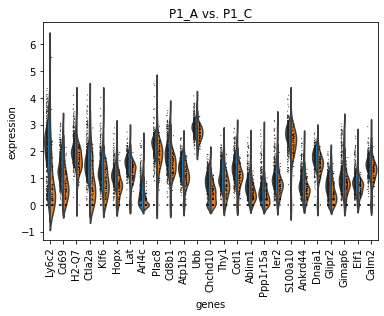

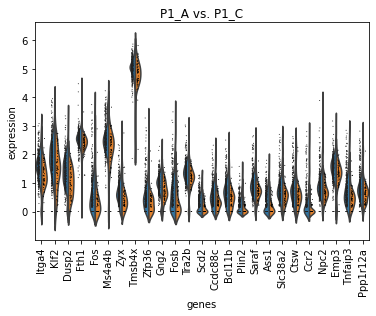

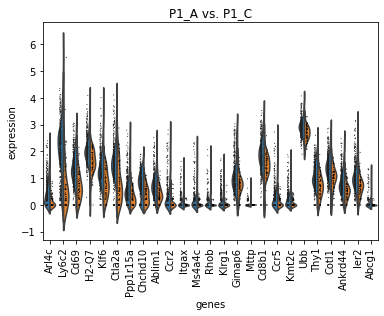

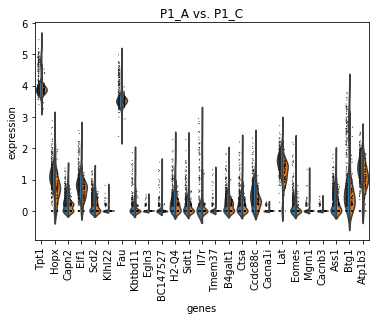

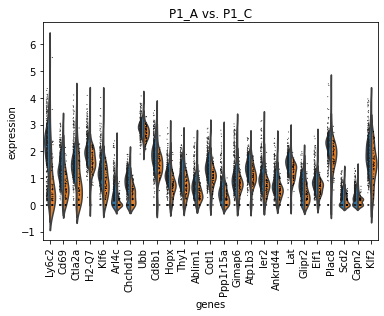

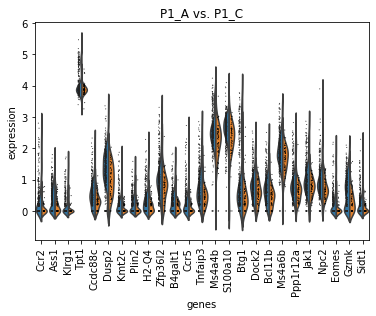

P1_C P1_A


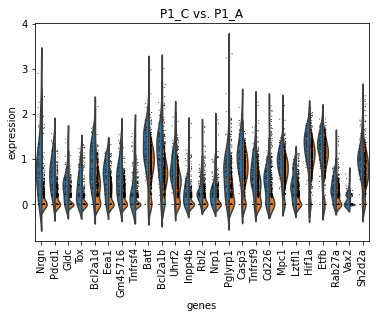

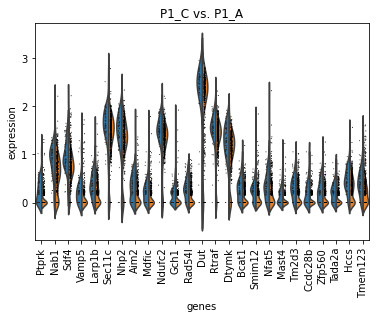

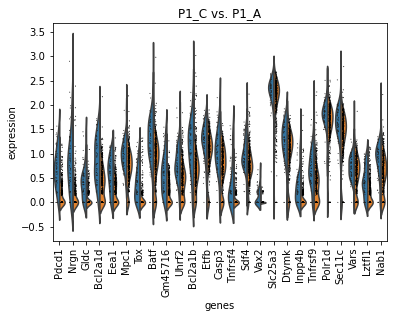

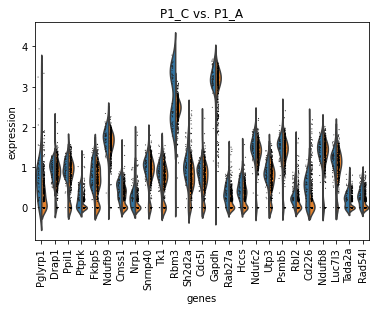

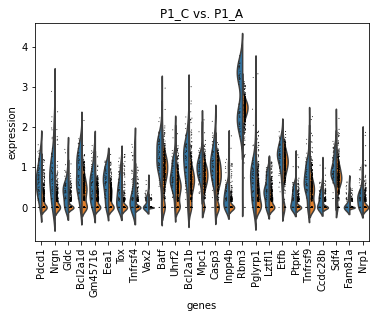

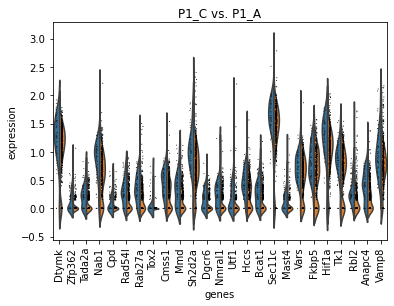

P2_A P2_C


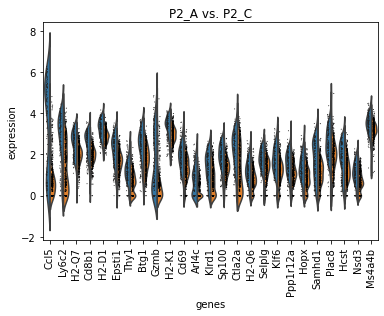

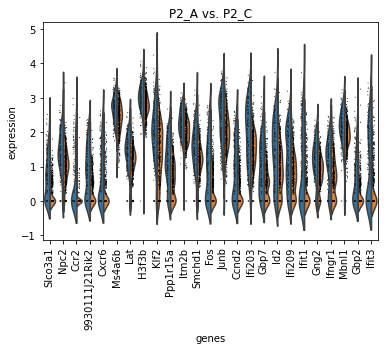

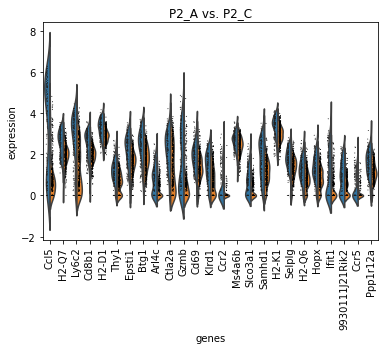

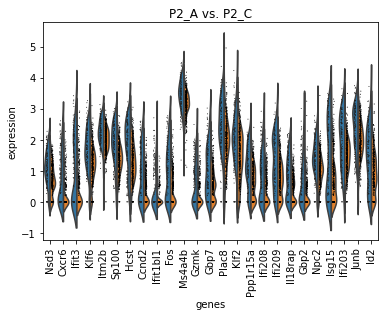

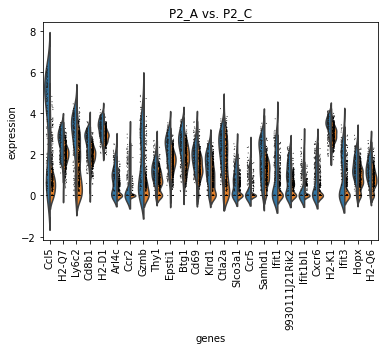

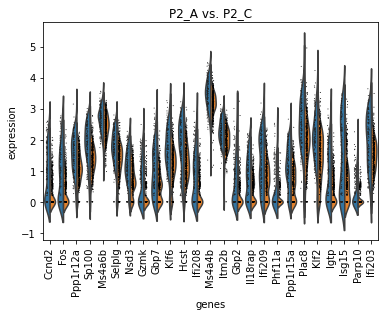

P2_C P2_A


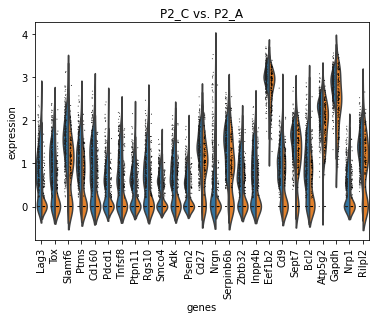

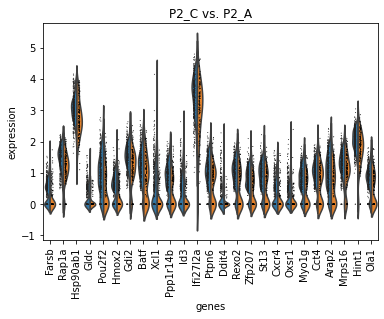

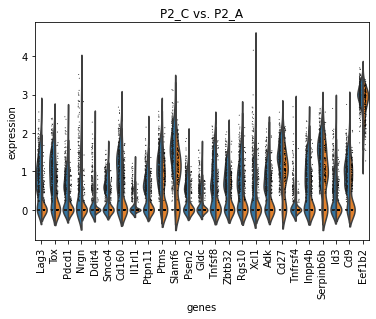

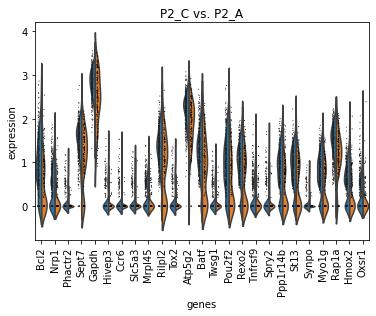

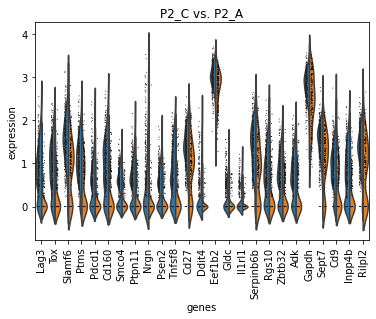

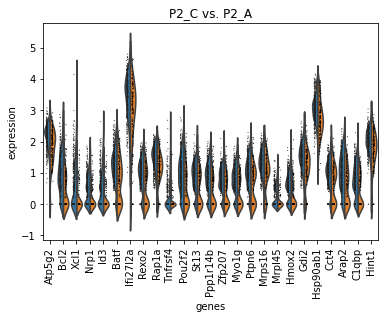

P3_A P3_C


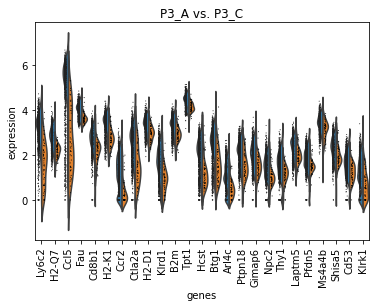

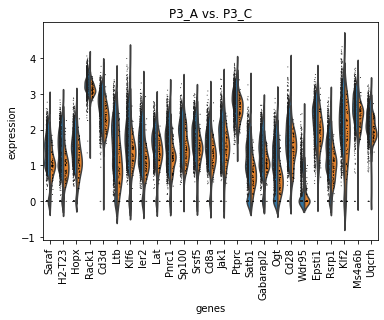

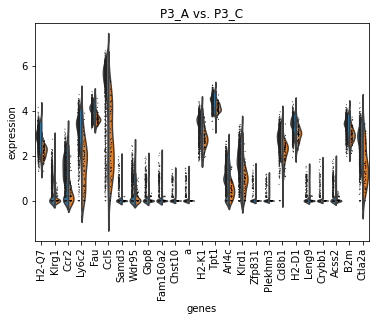

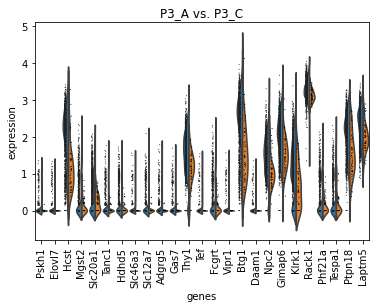

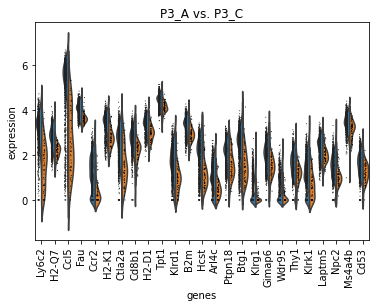

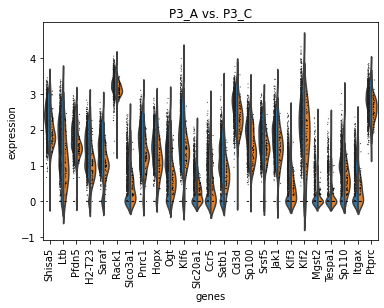

P3_C P3_A


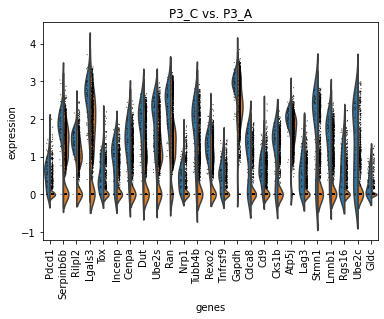

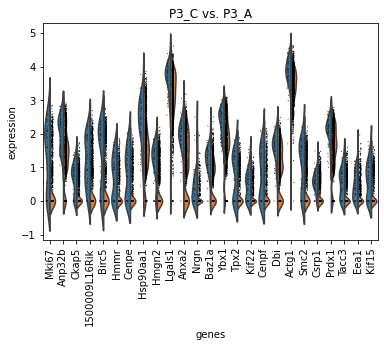

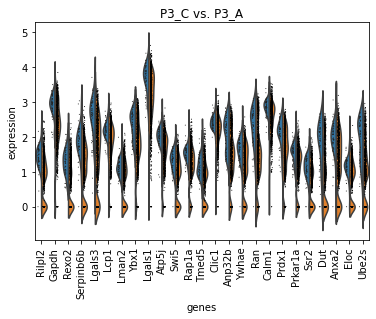

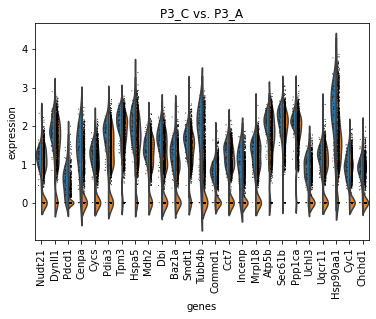

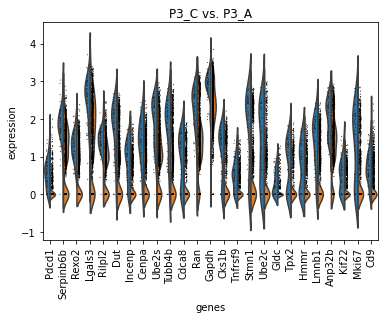

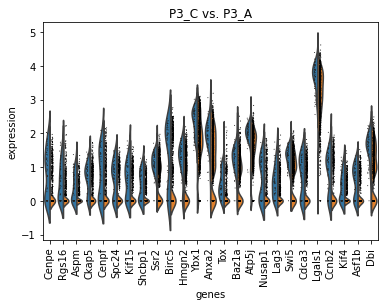

P5_A P5_C


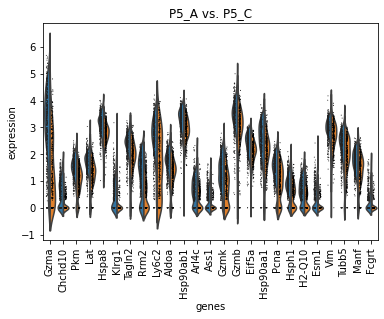

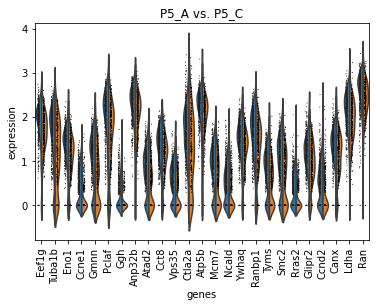

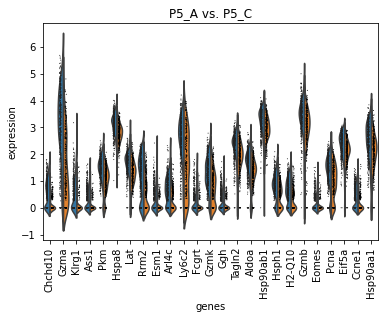

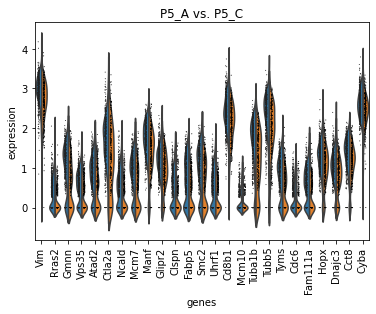

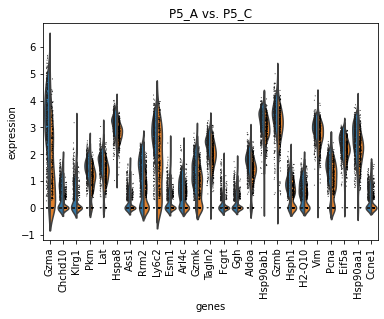

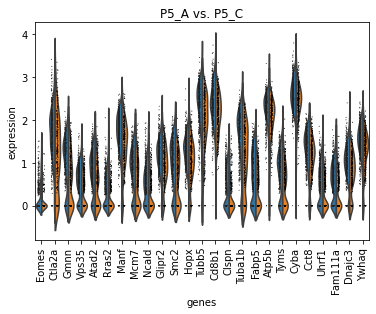

P5_C P5_A


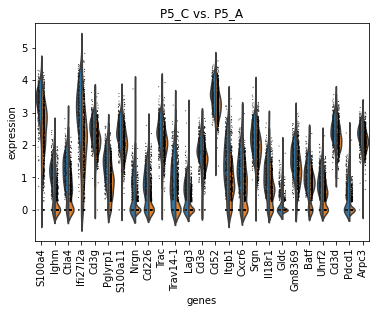

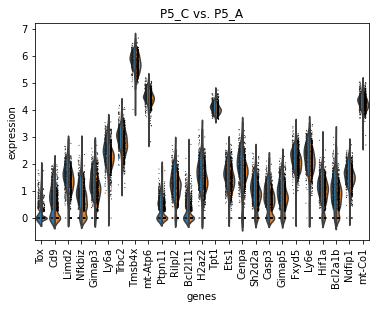

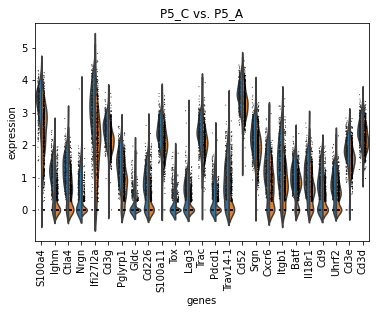

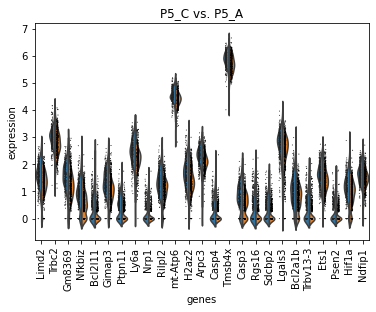

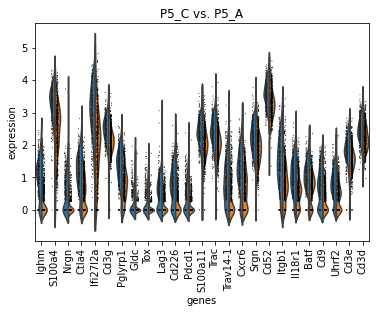

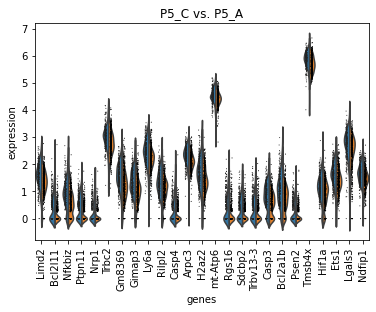

P6_A P6_C


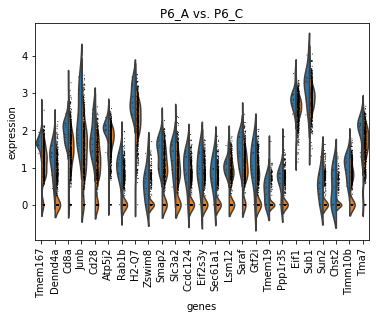

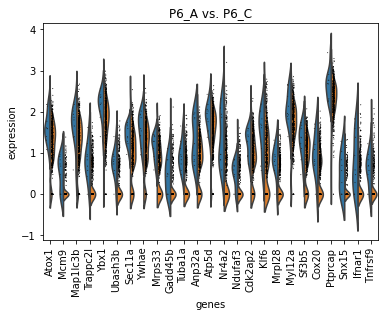

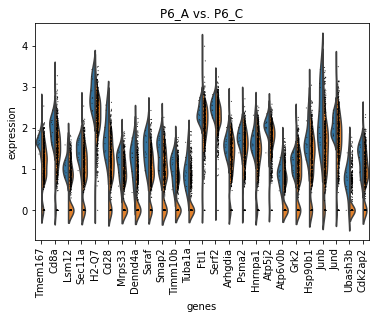

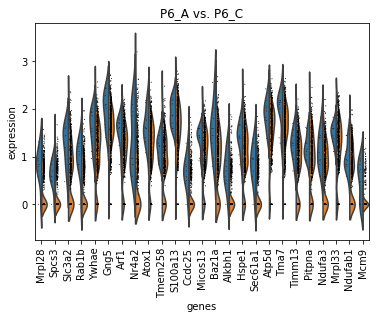

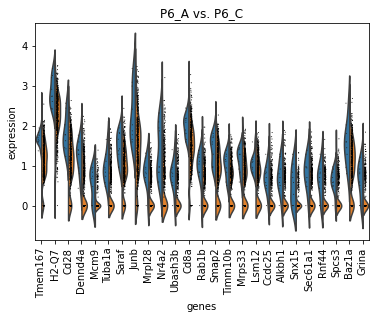

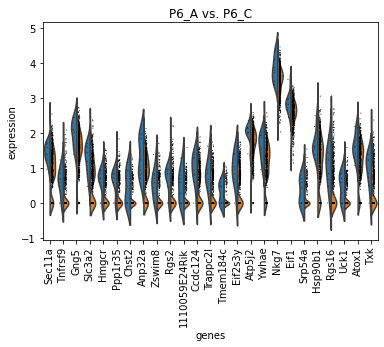

P6_C P6_A


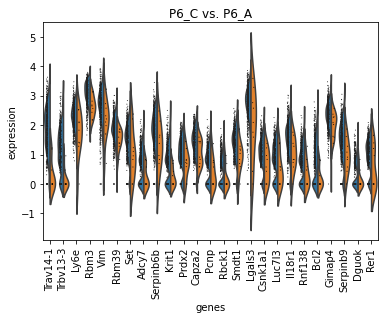

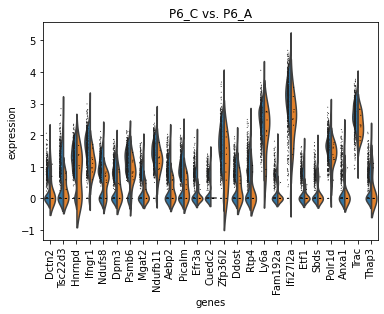

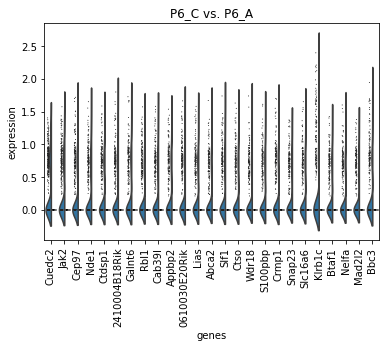

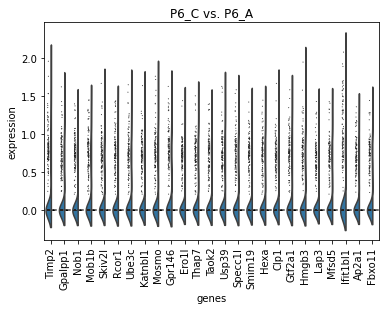

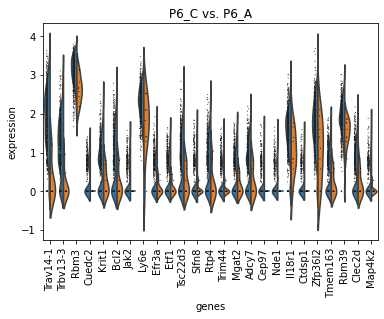

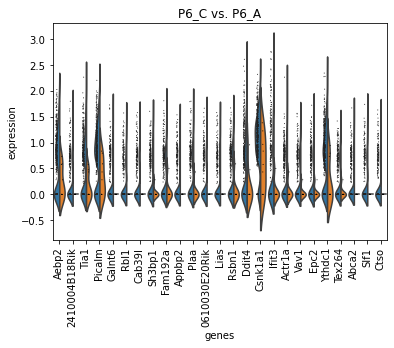

P7_A P7_C


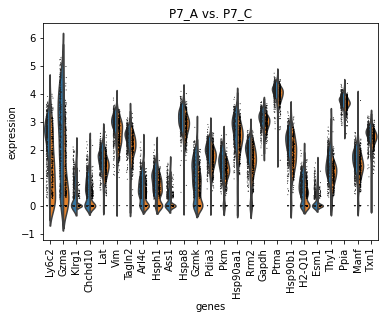

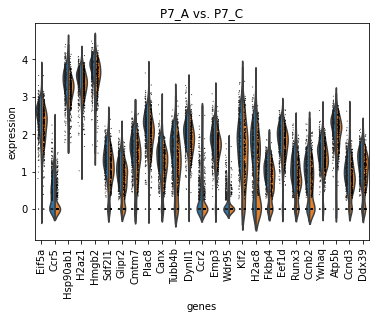

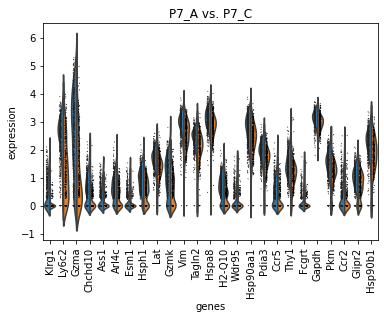

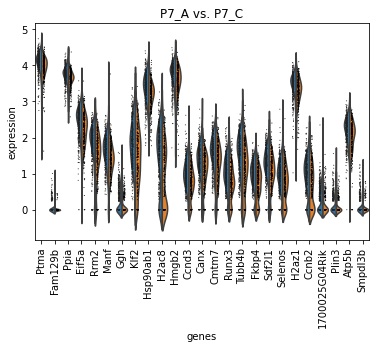

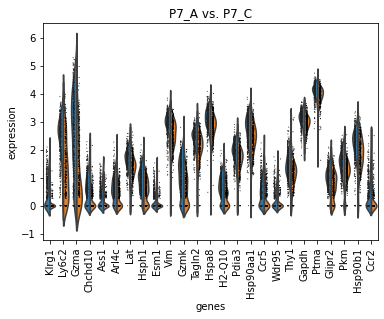

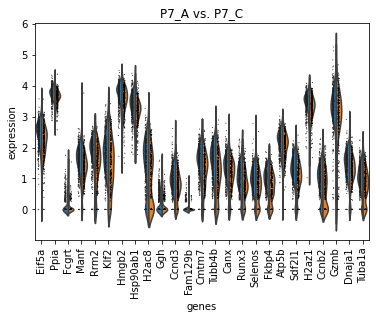

P7_C P7_A


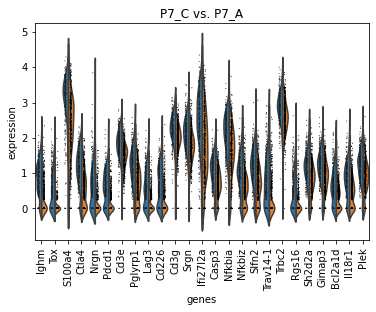

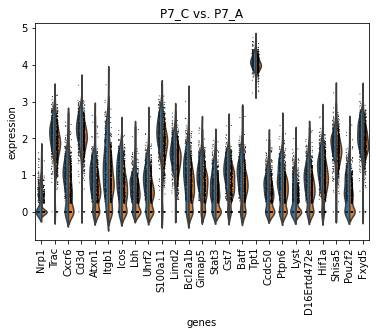

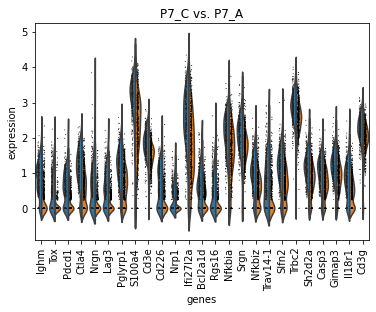

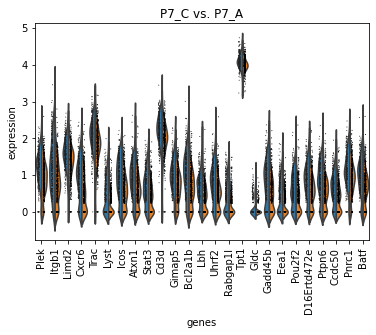

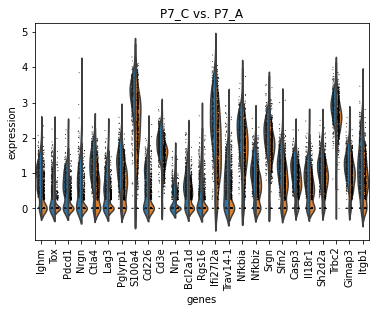

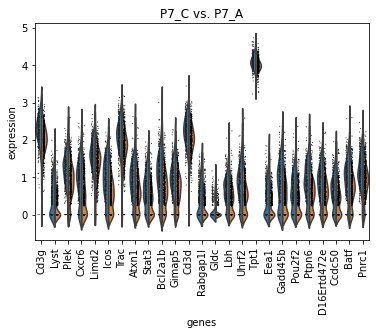

P8_A P8_C


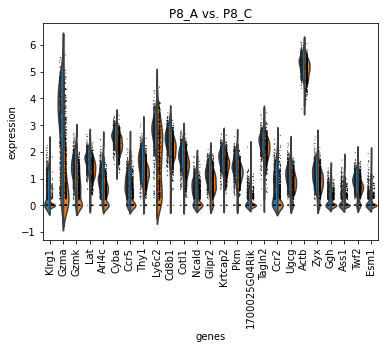

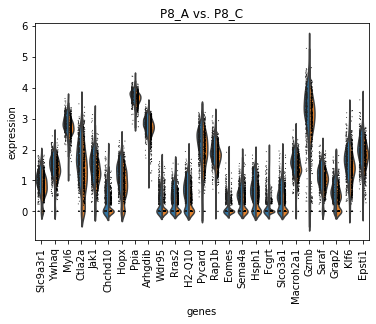

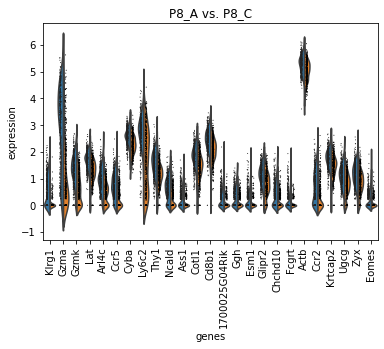

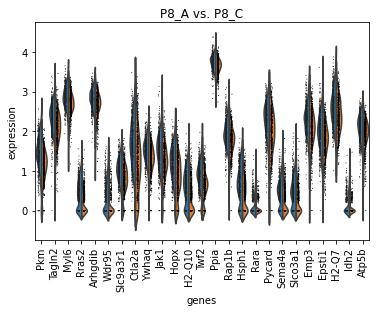

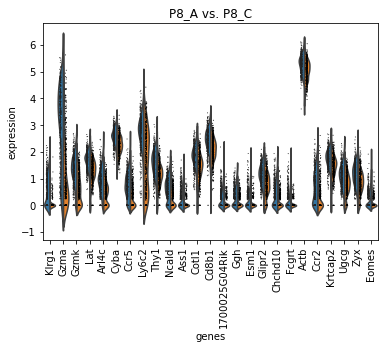

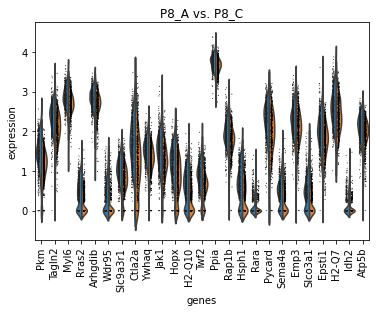

P8_C P8_A


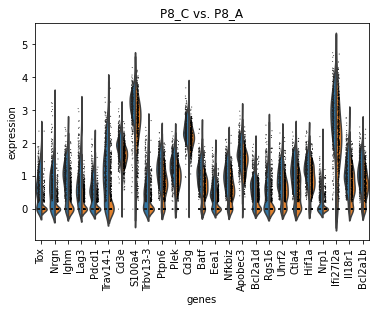

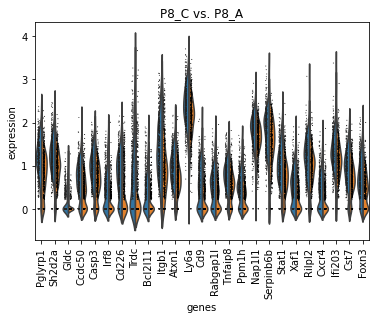

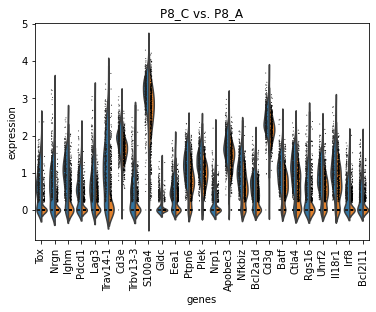

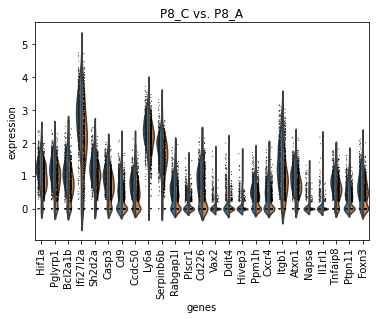

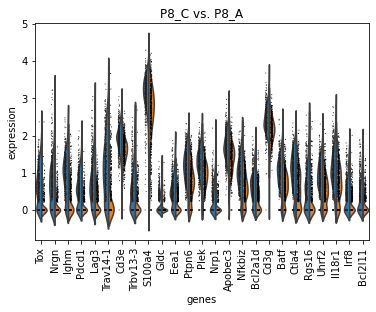

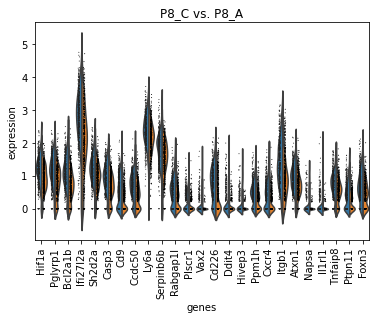

In [20]:
cps = ['wilcoxon', 't-test', 't-test_overestim_var']

for l_t in ["P1", "P2", "P3", "P5", "P6", "P7", "P8"]: # Do not use P0 (only NAV) and P4 (No Cl13)
    # Make a new folder for each cluster
    os.chdir(wk_dir)
    comparison = "%s_Arm_vs_Cl13"%l_t
    if not os.path.exists(comparison):
        os.mkdir(comparison)
    os.chdir(comparison)
    
    for a_c in [['A', 'C'], ['C', 'A']]:
            
            l_t_1 = "%s_%s"%(l_t, a_c[0])
            l_t_2 = "%s_%s"%(l_t, a_c[1])
            
            print(l_t_1, l_t_2)
            
            # Test result summary dataframe
            genes_df_l_t = pd.DataFrame({"gene_names":all_genes})
            dict_l_t = {}
            for cp in cps:
                # Run test
                sc.tl.rank_genes_groups(adata, obs_useCol, groups=[l_t_1], reference=l_t_2, method=cp, n_genes=gene_n)

                # Build dataframe with test results
                cp_names = [x[0] for x in adata.uns['rank_genes_groups']['names']]
                cp_fc = [x[0] for x in adata.uns['rank_genes_groups']['logfoldchanges']]
                cp_score = [x[0] for x in adata.uns['rank_genes_groups']['scores']]
                cp_padj = [x[0] for x in adata.uns['rank_genes_groups']['pvals_adj']]
                cp_df = pd.DataFrame({"gene_names":cp_names, "%s_logfc"%cp: cp_fc, "%s_padj"%cp:cp_padj, "%s_score"%cp:cp_score})
                #cp_df = cp_df[cp_df['%s_padj'%cp]<= 0.05]

                # Plot top 50 differential genes
                diff = cp_df['gene_names']
                diff_rmRp = [x for x in list(diff) if not x.startswith("Rp")]
                if (len(diff_rmRp) >= 25):
                    sc.pl.rank_genes_groups_violin(adata, groups=l_t_1, gene_names=diff_rmRp[:25], 
                                                   save="_vs_%s--%s-25.png"%(l_t_2, cp))
                if (len(diff_rmRp) >= 50):
                    sc.pl.rank_genes_groups_violin(adata, groups=l_t_1, gene_names=diff_rmRp[25:50], 
                                                   save="_vs_%s--%s-50.png"%(l_t_2, cp))



                # Merge with total dataframe
                genes_df_l_t = pd.merge(genes_df_l_t, cp_df, how='outer', on="gene_names")
                dict_l_t[cp] = cp_df['gene_names']
            
            # Save results for all tests
            genes_df_l_t.to_csv("%s_vs_%s_differential.csv"%(l_t_1, l_t_2), index=False)
            
            # Test comparison venn diagram
            venn3([set(dict_l_t[cps[0]]), set(dict_l_t[cps[1]]), set(dict_l_t[cps[2]])], tuple(cps))

            outname = "%s_vs_%s_venn.png"%(l_t_1, l_t_2)
            plt.savefig(outname)
            plt.close()

# 2.3 Differential Analysis for Arm v.s. Cl13 v.s. NAV in each time point

In [21]:
# Create day + cell type column
adata.obs['day'] = [x[1] for x in adata.obs['cell_type']]
adata.obs['day'] = [x.replace('P', '0') for x in adata.obs['day']]

adata.obs['day_cellType'] = ["%s_%s"%(str(x),y) for index,(x,y) in 
                                 enumerate(zip(list(adata.obs['day']),list( adata.obs['cell_type_general'])))]

### Config
obs_useCol = 'day_cellType'

... storing 'day' as categorical
... storing 'day_cellType' as categorical


5_A 5_C


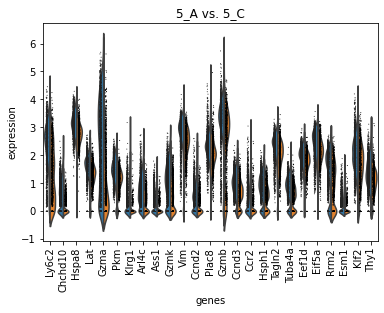

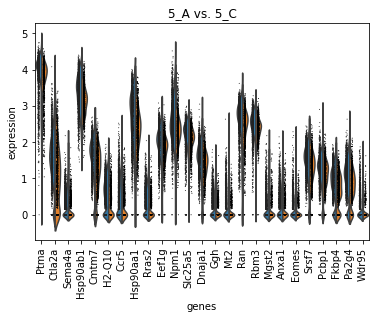

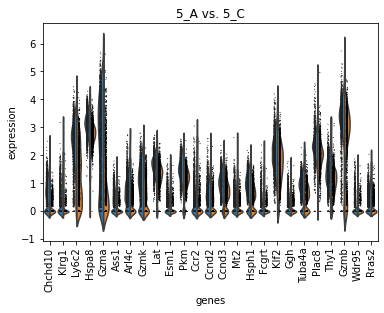

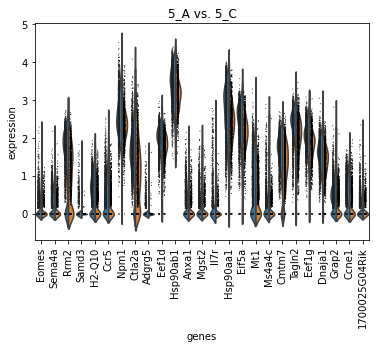

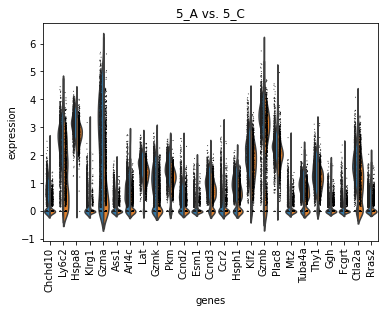

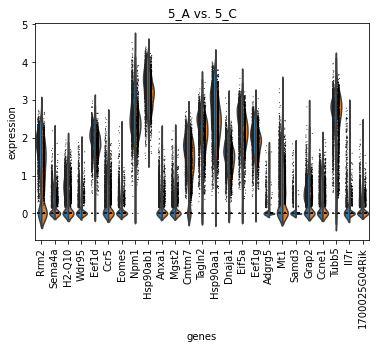

5_C 5_A


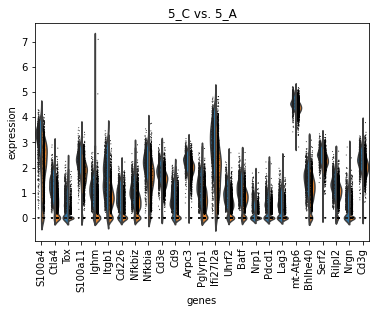

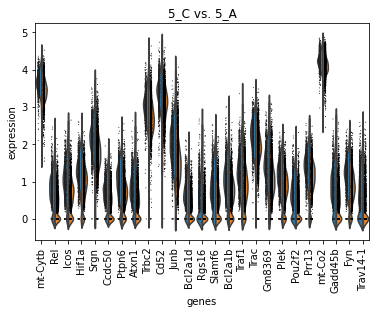

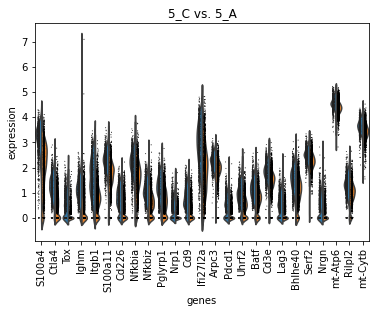

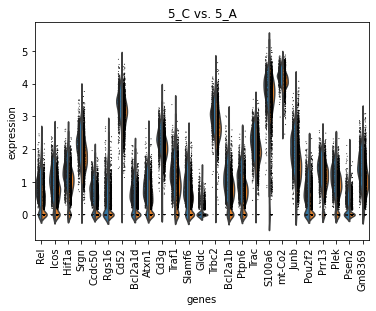

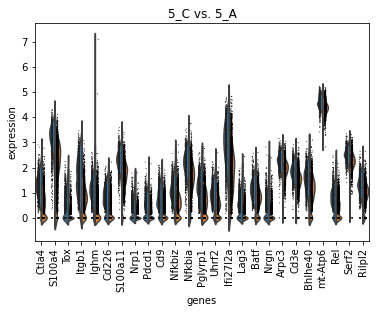

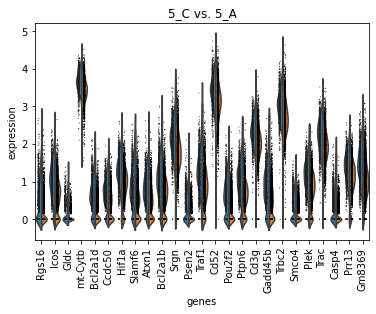

8_A 8_C


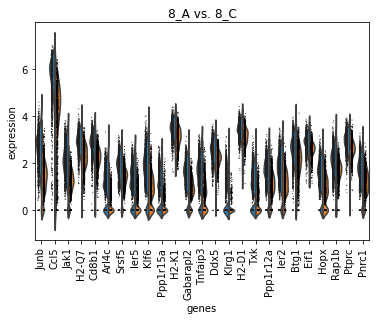

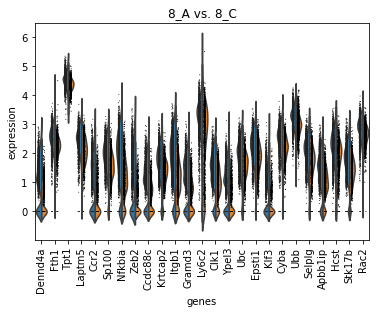

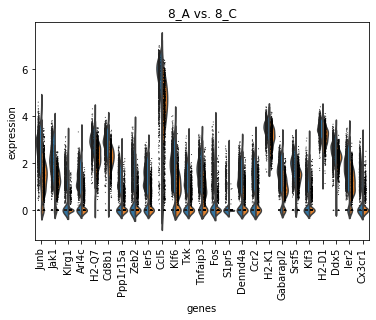

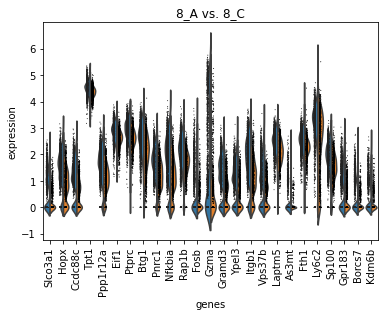

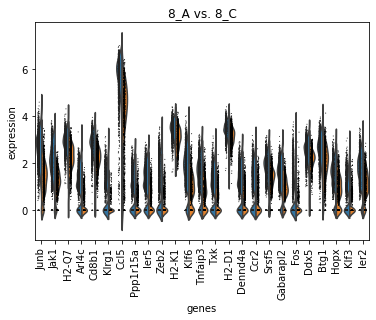

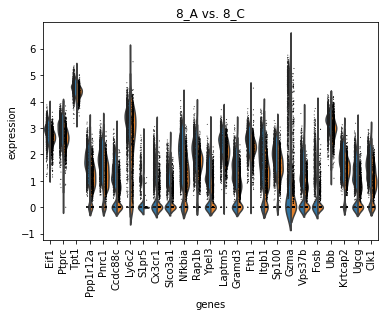

8_C 8_A


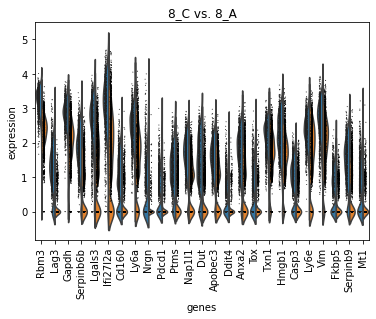

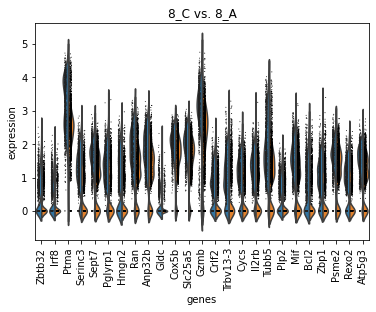

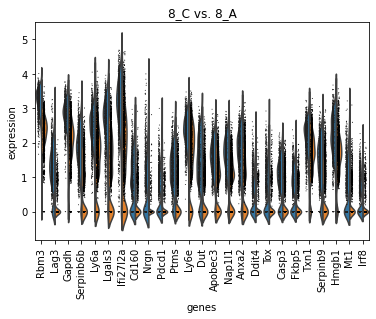

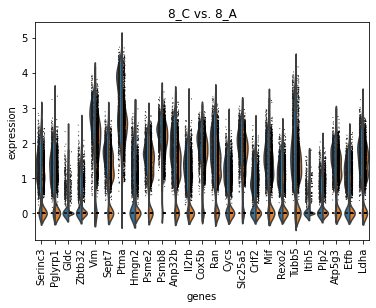

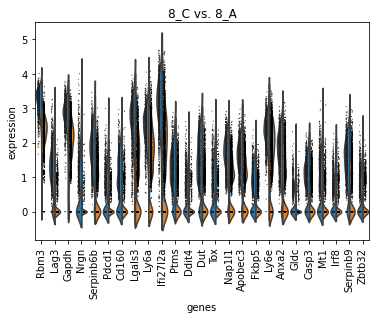

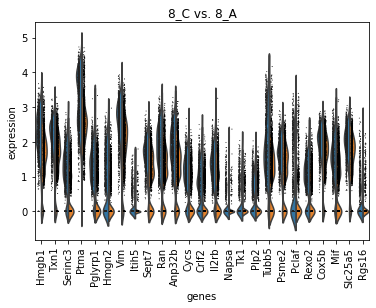

In [22]:
cps = ['wilcoxon', 't-test', 't-test_overestim_var']

for l_t in ['5', '8']: # Do not use P0 since it is naive cluster
    # Make a new folder for each cluster
    os.chdir(wk_dir)
    comparison = "day%s_Arm_vs_Cl13"%l_t
    if not os.path.exists(comparison):
        os.mkdir(comparison)
    os.chdir(comparison)
    
    for a_c in [['A', 'C'], ['C', 'A']]:
            
            l_t_1 = "%s_%s"%(l_t, a_c[0])
            l_t_2 = "%s_%s"%(l_t, a_c[1])
            
            print(l_t_1, l_t_2)
            
            # Test result summary dataframe
            genes_df_l_t = pd.DataFrame({"gene_names":all_genes})
            dict_l_t = {}
            for cp in cps:
                # Run test
                sc.tl.rank_genes_groups(adata, obs_useCol, groups=[l_t_1], reference=l_t_2, method=cp, n_genes=gene_n)

                # Build dataframe with test results
                cp_names = [x[0] for x in adata.uns['rank_genes_groups']['names']]
                cp_fc = [x[0] for x in adata.uns['rank_genes_groups']['logfoldchanges']]
                cp_score = [x[0] for x in adata.uns['rank_genes_groups']['scores']]
                cp_padj = [x[0] for x in adata.uns['rank_genes_groups']['pvals_adj']]
                cp_df = pd.DataFrame({"gene_names":cp_names, "%s_logfc"%cp: cp_fc, "%s_padj"%cp:cp_padj, "%s_score"%cp:cp_score})
                #cp_df = cp_df[cp_df['%s_padj'%cp]<= 0.05]

                # Plot top 50 differential genes
                diff = cp_df['gene_names']
                diff_rmRp = [x for x in list(diff) if not x.startswith("Rp")]
                if (len(diff_rmRp) >= 25):
                    sc.pl.rank_genes_groups_violin(adata, groups=l_t_1, gene_names=diff_rmRp[:25], 
                                                   save="_vs_%s--%s-25.png"%(l_t_2, cp))
                if (len(diff_rmRp) >= 50):
                    sc.pl.rank_genes_groups_violin(adata, groups=l_t_1, gene_names=diff_rmRp[25:50], 
                                                   save="_vs_%s--%s-50.png"%(l_t_2, cp))



                # Merge with total dataframe
                genes_df_l_t = pd.merge(genes_df_l_t, cp_df, how='outer', on="gene_names")
                dict_l_t[cp] = cp_df['gene_names']
            
            # Save results for all tests
            genes_df_l_t.to_csv("%s_vs_%s_differential.csv"%(l_t_1, l_t_2), index=False)
            
            # Test comparison venn diagram
            venn3([set(dict_l_t[cps[0]]), set(dict_l_t[cps[1]]), set(dict_l_t[cps[2]])], tuple(cps))

            outname = "%s_vs_%s_venn.png"%(l_t_1, l_t_2)
            plt.savefig(outname)
            plt.close()

# 2.4 Cell type v.s. Cell type

In [23]:
# Get set of labels
cell_type_uniq = list(set(adata.obs['cell_type']))
cell_type_uniq.sort()
cell_type_uniq

### Config
labels_uniq = cell_type_uniq
obs_useCol = 'cell_type'

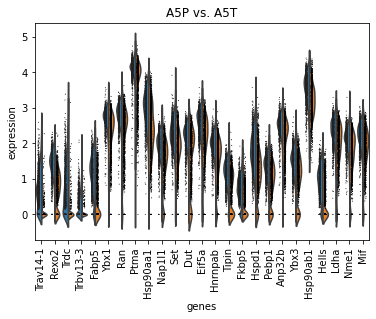

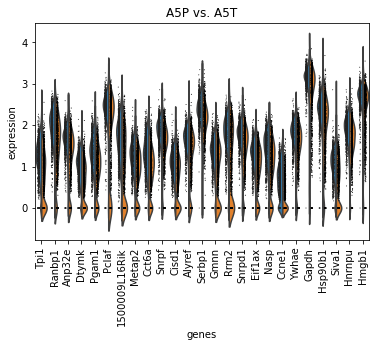

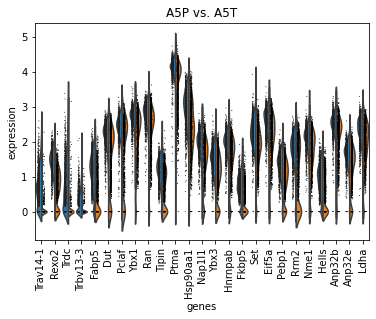

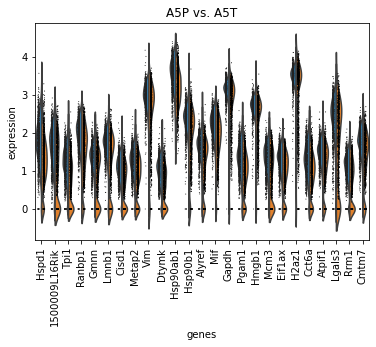

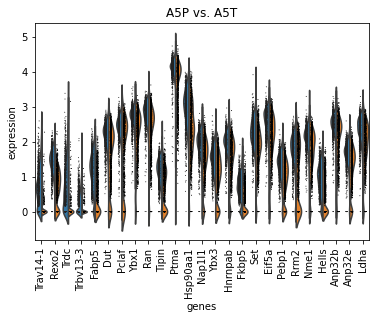

...

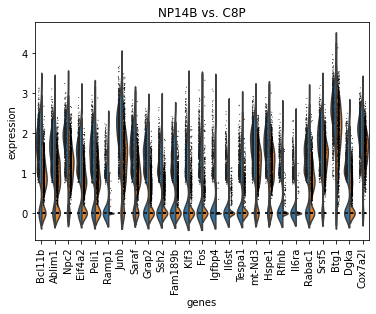

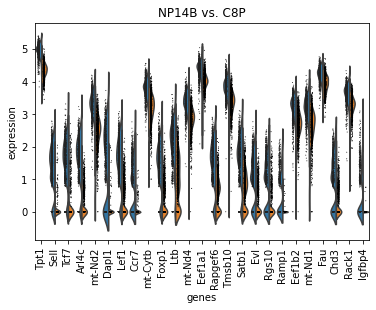

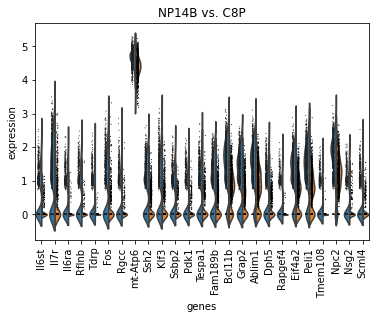

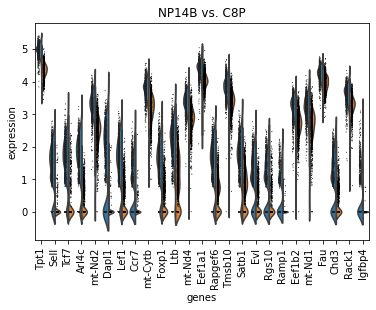

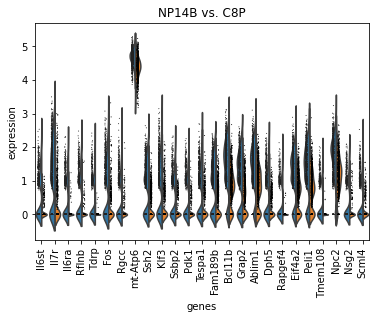

In [24]:
cps = ['wilcoxon', 't-test', 't-test_overestim_var']

for l_t_1 in labels_uniq:
    # Make a new folder for each cluster
    os.chdir(wk_dir)
    if not os.path.exists(l_t_1):
        os.mkdir(l_t_1)
    os.chdir(l_t_1)
    
    for l_t_2 in labels_uniq:
        if l_t_2 != l_t_1:
            
            # Test result summary dataframe
            genes_df_l_t = pd.DataFrame({"gene_names":all_genes})
            dict_l_t = {}
            for cp in cps:
                # Run test
                sc.tl.rank_genes_groups(adata, obs_useCol, groups=[l_t_1], reference=l_t_2, method=cp, n_genes=gene_n)

                # Build dataframe with test results
                cp_names = [x[0] for x in adata.uns['rank_genes_groups']['names']]
                cp_fc = [x[0] for x in adata.uns['rank_genes_groups']['logfoldchanges']]
                cp_score = [x[0] for x in adata.uns['rank_genes_groups']['scores']]
                cp_padj = [x[0] for x in adata.uns['rank_genes_groups']['pvals_adj']]
                cp_df = pd.DataFrame({"gene_names":cp_names, "%s_logfc"%cp: cp_fc, "%s_padj"%cp:cp_padj, "%s_score"%cp:cp_score})
                #cp_df = cp_df[cp_df['%s_padj'%cp]<= 0.05]

                # Plot top 50 differential genes
                diff = cp_df['gene_names']
                diff_rmRp = [x for x in list(diff) if not x.startswith("Rp")]
                if (len(diff_rmRp) >= 25):
                    sc.pl.rank_genes_groups_violin(adata, groups=l_t_1, gene_names=diff_rmRp[:25], 
                                                   save="_vs_%s--%s-25.png"%(l_t_2, cp))
                if (len(diff_rmRp) >= 50):
                    sc.pl.rank_genes_groups_violin(adata, groups=l_t_1, gene_names=diff_rmRp[25:50], 
                                                   save="_vs_%s--%s-50.png"%(l_t_2, cp))

                # Merge with total dataframe
                genes_df_l_t = pd.merge(genes_df_l_t, cp_df, how='outer', on="gene_names")
                dict_l_t[cp] = cp_df['gene_names']
            
            # Save results for all tests
            genes_df_l_t.to_csv("%s_vs_%s_differential.csv"%(l_t_1, l_t_2), index=False)
            
            # Test comparison venn diagram
            venn3([set(dict_l_t[cps[0]]), set(dict_l_t[cps[1]]), set(dict_l_t[cps[2]])], tuple(cps))

            outname = "%s_vs_%s_venn.png"%(l_t_1, l_t_2)
            plt.savefig(outname)
            plt.close()